# Imports

In [13]:
import os
import re
import librosa.display
import pandas as pd
import numpy as np
import IPython as ipd
import matplotlib.pyplot as plt

# os.environ["IMAGEIO_FFMPEG_EXE"] = "/opt/homebrew/Cellar/ffmpeg"

import moviepy.editor as mp

from typing import Any
from pathlib import Path
from yt_dlp import YoutubeDL
from __future__ import print_function

# Download Audio From YouTube

In [2]:
DATA_DIR = Path(os.path.abspath("")).parent / "data"

In [3]:
link = "https://www.youtube.com/watch?v=U8F5G5wR1mk"

with YoutubeDL({"outtmpl": "%(title)s"}) as video:
        video.download(link)

        print(os.listdir())

        info_dict = video.extract_info(link, download=False)

        file_found = False
        for file in os.listdir():
                if f"{info_dict['title']}" in file:
                        video_filename = file
                        file_found = True
                else:
                        continue

        if not file_found:
                raise FileNotFoundError(f"No file named {info_dict['title']}")

        audio_filename = f"{re.sub('[\W_]+', '_', info_dict['title'])}.mp3"

        clip = mp.VideoFileClip(video_filename)

        print("\nConverting file to mp3 ....")

        clip.audio.write_audiofile(filename=DATA_DIR / audio_filename, verbose=False, logger=None)

        print("Conversion Complete!")

        os.remove(video_filename)

        clip.close()

ipd.display.Audio(DATA_DIR / audio_filename)

[youtube] Extracting URL: https://www.youtube.com/watch?v=U8F5G5wR1mk
[youtube] U8F5G5wR1mk: Downloading webpage
[youtube] U8F5G5wR1mk: Downloading ios player API JSON
[youtube] U8F5G5wR1mk: Downloading mweb player API JSON
[youtube] U8F5G5wR1mk: Downloading m3u8 information
[info] U8F5G5wR1mk: Downloading 1 format(s): 616+251
[hlsnative] Downloading m3u8 manifest
[hlsnative] Total fragments: 32
[download] Destination: Kendrick Lamar - tv off (Official Audio).f616.mp4
[download] 100% of    8.04MiB in 00:00:01 at 5.57MiB/s                   
[download] Destination: Kendrick Lamar - tv off (Official Audio).f251.webm
[download] 100% of    3.53MiB in 00:00:00 at 33.51MiB/s  
[Merger] Merging formats into "Kendrick Lamar - tv off (Official Audio).webm"
Deleting original file Kendrick Lamar - tv off (Official Audio).f616.mp4 (pass -k to keep)
Deleting original file Kendrick Lamar - tv off (Official Audio).f251.webm (pass -k to keep)
['scratch_paper.ipynb', 'Kendrick Lamar - tv off (Official 

# Source Separation

In [5]:
y, sr = librosa.load(DATA_DIR / audio_filename)

# compute the spectrogram magnitude and phase
# librosa.magphase: separates a complex-valued spectrogram D into its magnitude (S) and phse (P)components, so that D = S * P
# magnitude: describes the strength of each frequency in the signal
# phase: the position of a wave at a specific time on a waveform cycle

S_full, phase = librosa.magphase(librosa.stft(y))

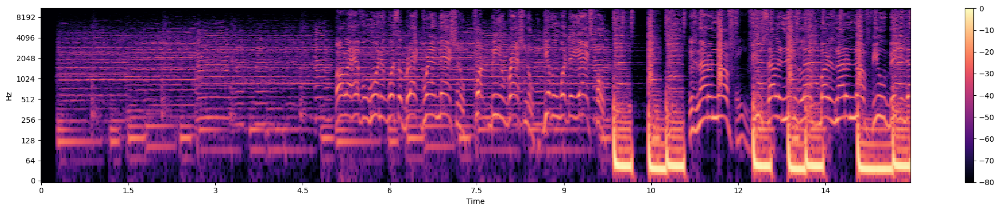

In [6]:
# plot spectrogram

idx = slice(*librosa.time_to_frames([0, 15], sr=sr))

plt.figure(figsize=(21, 4))

librosa.display.specshow(
    librosa.amplitude_to_db(S_full[:, idx], ref=np.max), 
    y_axis="log", 
    x_axis="time", 
    sr=sr
)

plt.colorbar()
plt.tight_layout()

ipd.display.Audio(data=y, rate=sr)

In [7]:
# Compare frames using cosine similarity, and aggregate similar frames
# by taking their (pre-frequency) median value

S_filter = librosa.decompose.nn_filter(
    S_full, 
    aggregate=np.median, 
    metric="cosine", 
    width=int(librosa.time_to_frames(2, sr=sr))
)

# Output of the filter shouldn't be greater than the input
S_filter = np.minimum(S_full, S_filter)

In [8]:
# Using a margin to reduce bleed between the vocals and instrumentation masks
margin_i, margin_v = 2, 10
power = 2

mask_i = librosa.util.softmask(
    S_filter,
    margin_i * (S_full - S_filter),
    power=power
)

mask_v = librosa.util.softmask(
    S_full - S_filter,
    margin_v * S_filter,
    power=power
)

# once we have the mast , multiple them with the input spectrum to separate components
S_foreground = mask_v * S_full
S_background = mask_i * S_full

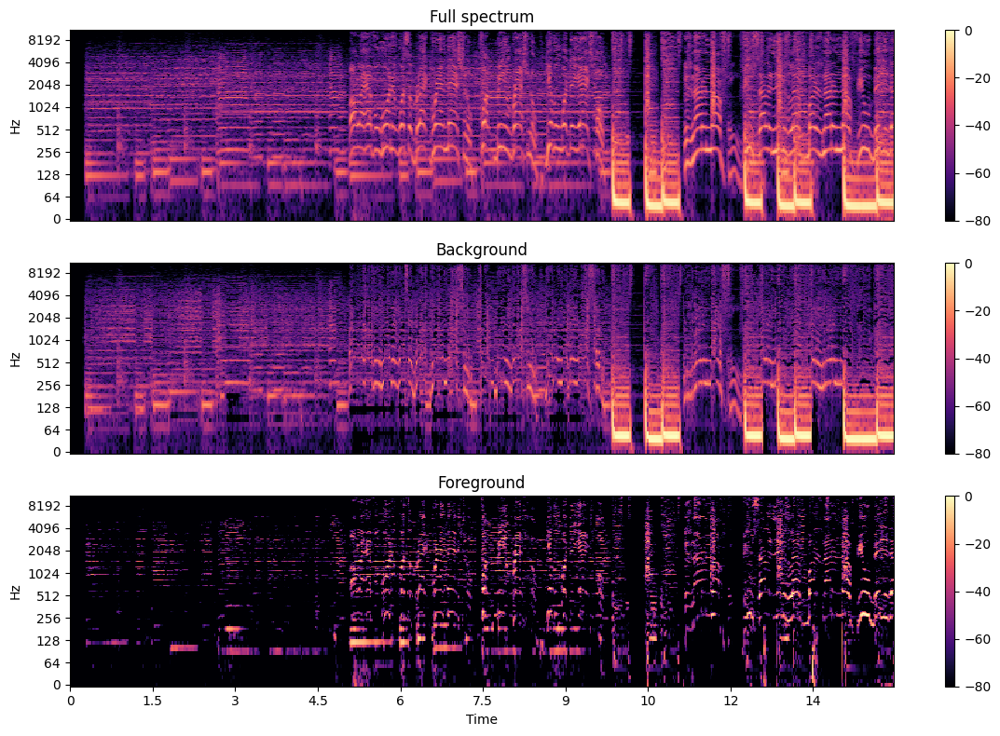

In [9]:
# plot full spectrum, forground and background

plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
librosa.display.specshow(
    librosa.amplitude_to_db(S_full[:, idx], ref=np.max),
    y_axis="log",
    sr=sr
)
plt.title("Full spectrum")
plt.colorbar()


plt.subplot(3, 1, 2)
librosa.display.specshow(
    librosa.amplitude_to_db(S_background[:, idx], ref=np.max),
    y_axis="log",
    sr=sr
)
plt.title("Background")
plt.colorbar()


plt.subplot(3, 1, 3)
librosa.display.specshow(
    librosa.amplitude_to_db(S_foreground[:, idx], ref=np.max),
    y_axis="log",
    x_axis="time",
    sr=sr
)
plt.title("Foreground")
plt.colorbar()

plt.tight_layout()
plt.show()

In [12]:
librosa.__version__

'0.10.2.post1'

In [13]:
import soundfile

In [15]:
# re-introduce the phase information that we had previosuly set asisde

y_foreground = librosa.istft(S_foreground * phase)

# play back 5 seconds with cocals

ipd.display.Audio(data=y_foreground[0*sr:50*sr], rate=sr)

In [40]:
# background 

background = librosa.istft(S_background * phase)

ipd.display.Audio(data=background[0*sr: 50*sr], rate=sr)